In [ ]:
import json
import torch
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision import models
from PIL import Image
import numpy as np
from pycocotools.coco import COCO
import torchvision
import matplotlib.pyplot as plt

# Paths to directories and annotation files
train_image_dir = "/content/dataset/train"
val_image_dir = "/content/dataset/valid"
test_image_dir = "/content/dataset/test"
train_annotation_path = "/content/annotation/train_annotations.coco.json"
val_annotation_path = "/content/annotation/valid_annotations.coco.json"
test_annotation_path = "/content/annotation/test_annotations.coco.json"

batch_size = 8
num_classes = 3

# Custom Dataset Class
class CustomCocoDataset(Dataset):
    def __init__(self, image_dir, annotation_path, transform=None):
        self.image_dir = image_dir
        self.coco = COCO(annotation_path)
        self.image_ids = list(self.coco.imgs.keys())
        self.transform = transform

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        ann_ids = self.coco.getAnnIds(imgIds=image_id)
        anns = self.coco.loadAnns(ann_ids)

        image_info = self.coco.loadImgs(image_id)[0]
        image_path = f"{self.image_dir}/{image_info['file_name']}"
        image = Image.open(image_path).convert("RGB")

        # Prepare ground-truth masks and bounding boxes from annotations
        boxes = []
        labels = []
        masks = []
        for ann in anns:
            bbox = ann['bbox']
            xmin, ymin, width, height = bbox
            boxes.append([xmin, ymin, xmin + width, ymin + height])
            labels.append(ann['category_id'])

            # Convert annotation to mask and resize to match the image's original dimensions
            mask = self.coco.annToMask(ann)
            mask = Image.fromarray(mask).resize((image_info['width'], image_info['height']), Image.NEAREST)
            masks.append(torch.as_tensor(np.array(mask), dtype=torch.uint8))

        # Convert lists to tensors
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        masks = torch.stack(masks, dim=0)

        target = {
            'boxes': boxes,
            'labels': labels,
            'masks': masks
        }

        if self.transform:
            image = self.transform(image)

        return image, target

# Data Transformations (Normalization and Augmentation)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Custom collate function to handle variable-sized tensors
def custom_collate_fn(batch):
    images = [item[0] for item in batch]
    targets = [{k: v for k, v in item[1].items()} for item in batch]
    return images, targets

# Create dataset instances for train, validation, and test sets
train_dataset = CustomCocoDataset(train_image_dir, train_annotation_path, transform=transform)
val_dataset = CustomCocoDataset(val_image_dir, val_annotation_path, transform=transform)
test_dataset = CustomCocoDataset(test_image_dir, test_annotation_path, transform=transform)

# DataLoaders for each partition, using custom collate_fn
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=custom_collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=custom_collate_fn)

# Load and modify Mask R-CNN model
model = torchvision.models.detection.maskrcnn_resnet50_fpn(weights="DEFAULT")

# Freeze all layers
for param in model.parameters():
    param.requires_grad = False

# Adjust the last layers to the number of classes and unfreeze them
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)
model.roi_heads.mask_predictor = torchvision.models.detection.mask_rcnn.MaskRCNNPredictor(256, num_classes, 28)

# Unfreeze the last layers for training
for param in model.roi_heads.box_predictor.parameters():
    param.requires_grad = True
for param in model.roi_heads.mask_predictor.parameters():
    param.requires_grad = True

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

#calculate average loss
def calculate_average_loss(model, data_loader):
    model.train()
    total_loss = 0.0
    num_batches = 0

    with torch.no_grad():
        for images, targets in data_loader:
            images = [image.to(device) for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Forward pass and calculate loss
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
            total_loss += losses.item()
            num_batches += 1

    average_loss = total_loss / num_batches
    model.eval()  # Switch back to evaluation mode after calculating loss
    return average_loss

# Calculate and print average loss for training and validation datasets
train_loss = calculate_average_loss(model, train_loader)
val_loss = calculate_average_loss(model, val_loader)

print(f"Average Training Loss: {train_loss:.4f}")
print(f"Average Validation Loss: {val_loss:.4f}")


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Average Training Loss: 2.3761
Average Validation Loss: 2.2804


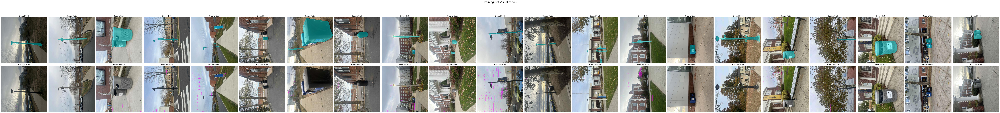

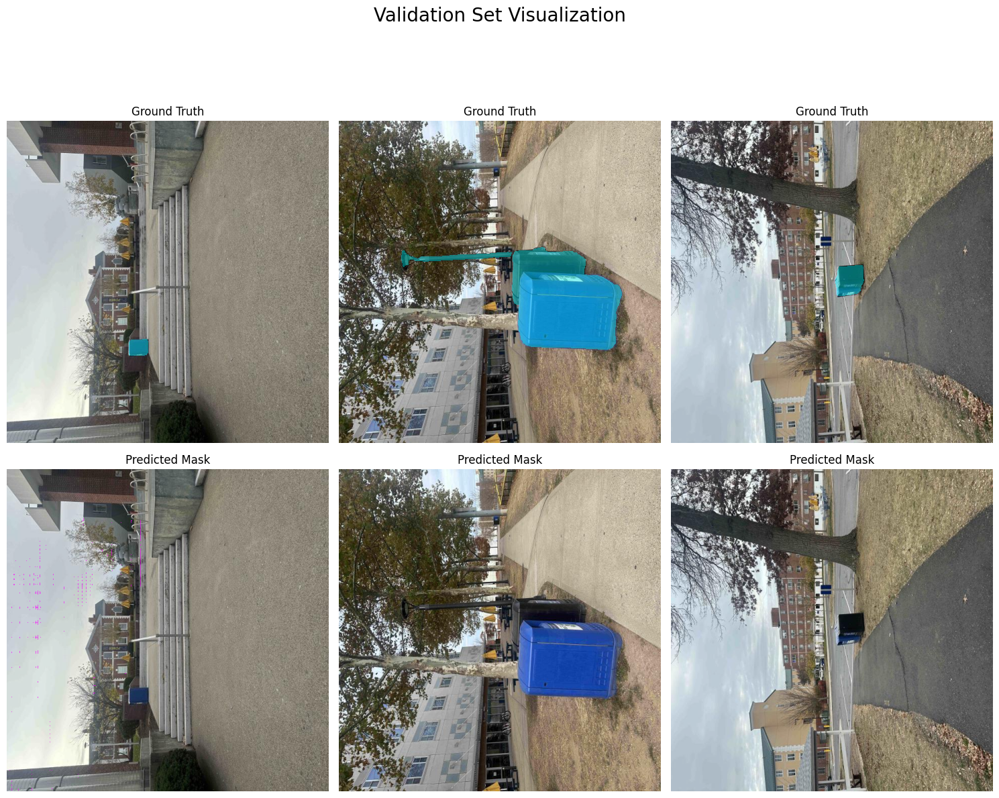

In [12]:
def visualize_with_ground_truth(loader, dataset_name="Dataset", confidence_threshold=0.3):
    model.eval()
    with torch.no_grad():
        num_batches = len(loader)
        fig, axes = plt.subplots(2, num_batches, figsize=(5 * num_batches, 12))
        fig.suptitle(f"{dataset_name} Set Visualization", fontsize=20, y=1.02)

        for batch_idx, (images, targets) in enumerate(loader):
            axes[0, batch_idx].cla()
            axes[1, batch_idx].cla()

            # Get the first image and target from each minibatch
            image = images[0].to(device)
            target = targets[0]
            output = model([image])[0]  # Model output for the first image

            # Prepare the image for display
            img = image.permute(1, 2, 0).cpu().numpy()
            img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  # Denormalize
            img = np.clip(img, 0, 1)

            # Display original image with ground-truth mask
            ax1 = axes[0, batch_idx]
            ax1.imshow(img)
            for gt_mask in target['masks']:
                ax1.imshow(np.ma.masked_where(gt_mask.cpu().numpy() == 0, gt_mask.cpu().numpy()), cmap='cool', alpha=0.4)
            ax1.set_title(f"Ground Truth", fontsize=12)
            ax1.axis('off')

            # Display original image with predicted mask if available
            ax2 = axes[1, batch_idx]
            ax2.imshow(img)
            if "masks" in output and len(output["masks"]) > 0:
                for i, pred_mask in enumerate(output["masks"]):
                    score = output["scores"][i].item()
                    if score >= confidence_threshold:  # Filter by confidence score
                        pred_mask = pred_mask[0].cpu().numpy() > 0.5
                        ax2.imshow(np.ma.masked_where(pred_mask == 0, pred_mask), cmap='spring', alpha=0.6)
            ax2.set_title(f"Predicted Mask", fontsize=12)
            ax2.axis('off')

        plt.subplots_adjust(wspace=0.2, hspace=0.2)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()

model.to(device)

# Visualize the first sample of each minibatch for the training set and validation set
visualize_with_ground_truth(train_loader, dataset_name="Training", confidence_threshold=0.3)

visualize_with_ground_truth(val_loader, dataset_name="Validation", confidence_threshold=0.3)